#### Görüntü biçimi - Örnekleme ve Niceleme

In [2]:
#% matplotlib inline 
from PIL import Image
from skimage.io import imread, imshow, show
import scipy.fftpack as fp
from scipy import ndimage, misc, signal
#from scipy.stats import signaltonoise - yeni versiyonda kaldırılmış
from skimage import data, img_as_float
from skimage.color import rgb2gray
from skimage.transform import rescale
import matplotlib.pylab as pylab
import numpy as np
import numpy.fft
import timeit


def signaltonoise(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return np.where(sd == 0, 0, m/sd)

#### Up-sampling
Bölüm 1, Görüntü İşlemeye Başlarken'de kısaca tartışıldığı gibi, bir görüntünün boyutunu artırmak için 
görüntüyü yukarı örneklememiz gerekir. 
Buradaki zorluk, yeni büyük görüntülerin orijinal küçük görüntüde karşılık gelen piksele sahip olmayan 
bazı piksellere sahip olacağı ve bu bilinmeyen piksel değerlerini tahmin etmemiz gerektiğidir. 
Bilinmeyen bir pikselin değerini aşağıdakileri kullanarak tahmin edebiliriz:
    1-Bir toplam(aggregate), örneğin, bilinen en yakın bir veya daha fazla piksel komşusu değerinin ortalama değeri
    2-bilinear veya kübik enterpolasyon ile piksel komşuları kullanılarak enterpole edilmiş bir değer.


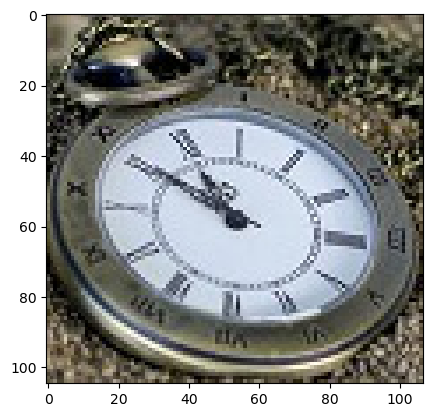

(<matplotlib.image.AxesImage at 0x26c1a7ad2e0>, None)

In [3]:
im = Image.open("Ims/clock.jpg")
pylab.imshow(im), pylab.show()

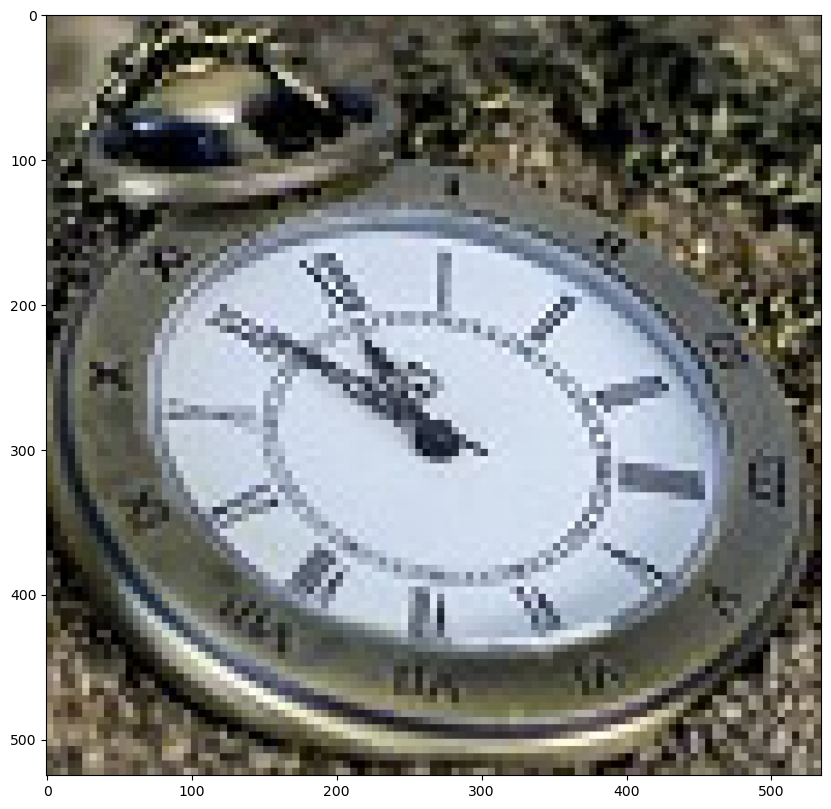

(<Figure size 1000x1000 with 1 Axes>,
 None)

In [4]:
#Orijinal görüntünün genişliğini ve yüksekliğini beş katına çıkar (görüntü boyutunu 25 kat artırır):
im1 = im.resize((im.width*5, im.height*5), Image.NEAREST) # nearest neighbor interpolation
pylab.figure(figsize=(10,10)), pylab.imshow(im1), pylab.show()

Yukarı örneklenmiş çıktı görüntü kalitesini iyileştirmek için, bi-lineer veya bi-kübik enterpolasyon yöntemleri kullanılabilir.
Bi-linear interpolation
2B gri tonlamalı bir görüntü ele alalım:
Bu durumda, her olası P noktası için (enterpolasyon yapmak istediğimiz) dört komşu (yani, Q11, Q12, Q22 ve Q21) olacak
ve bu dört komşunun yoğunluk değerleri, aşağıdaki şekilde gösterildiği gibi P noktasındaki 
enterpole edilmiş yoğunluğu hesaplamak için birleştirilecektir:
    

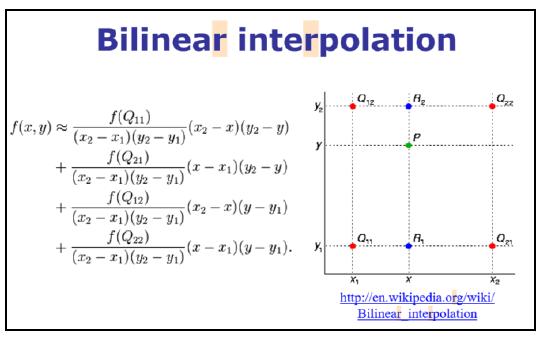

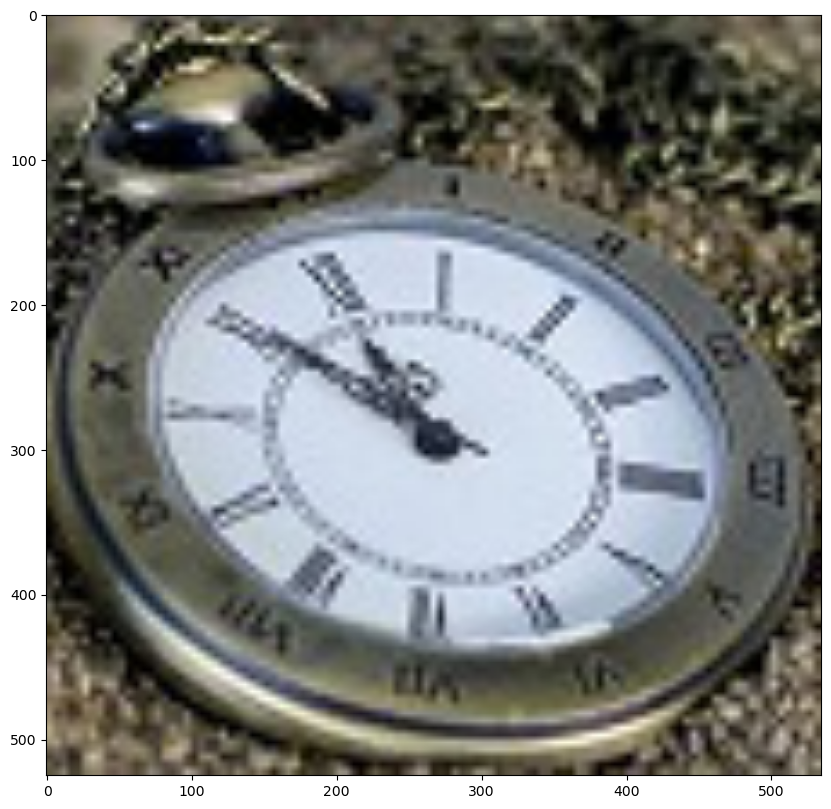

(<Figure size 1000x1000 with 1 Axes>,
 None)

In [5]:
im1 = im.resize((im.width*5, im.height*5), Image.BILINEAR) # bi-linear interpolation
pylab.figure(figsize=(10,10)), pylab.imshow(im1), pylab.show()

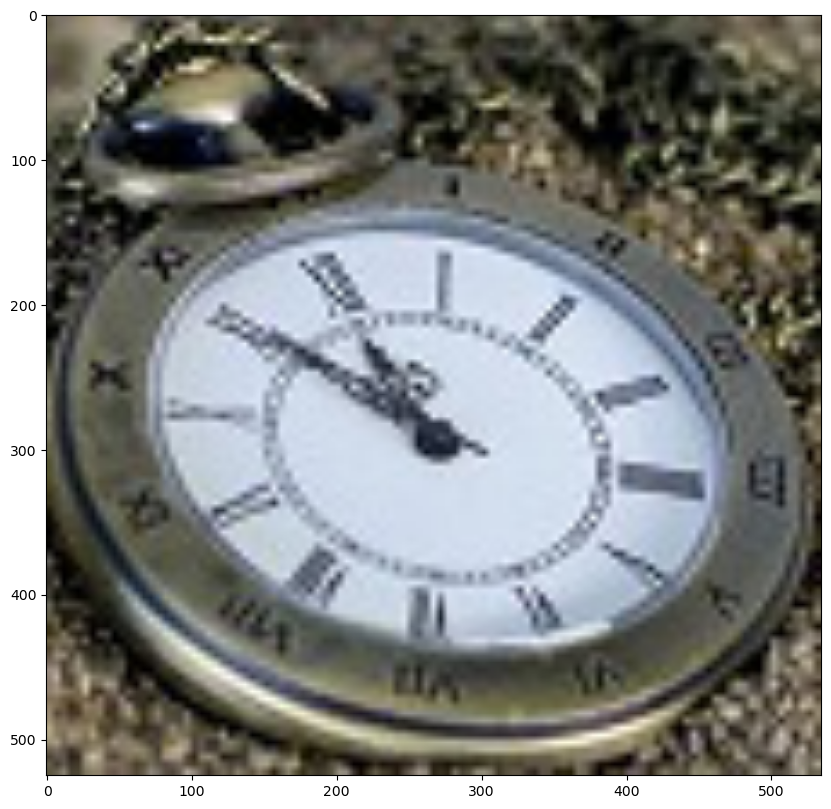

(<Figure size 1000x1000 with 1 Axes>,
 None)

In [6]:
#Bi-cubic interpolation
#Enterpole edilen yüzey, genellikle daha pürüzsüzdür.

im.resize((im.width*10, im.height*10), Image.BICUBIC).show() # bi-cubic interpolation
pylab.figure(figsize=(10,10)), pylab.imshow(im1), pylab.show()

Text(0.5, 1.0, 'bi-cubic interpolation')

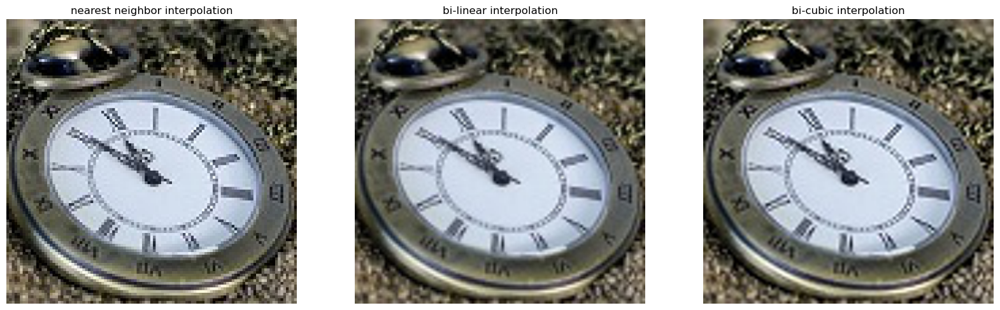

In [7]:
pylab.figure(figsize=(20,15))
im1 = im.resize((im.width*5, im.height*5), Image.NEAREST) # nearest neighbor interpolation
pylab.subplot(1,3,1), pylab.imshow(im1), pylab.axis('off')
pylab.title('nearest neighbor interpolation')
im1 = im.resize((im.width*5, im.height*5), Image.BILINEAR) # bi-linear interpolation
pylab.subplot(1,3,2), pylab.imshow(im1), pylab.axis('off')
pylab.title('bi-linear interpolation')
im1 = im.resize((im.width*5, im.height*5), Image.BICUBIC) # bi-cubic interpolation
pylab.subplot(1,3,3), pylab.imshow(im1), pylab.axis('off')
pylab.title('bi-cubic interpolation')

#### Down sampling
Bir görüntünün boyutunu küçültmek için görüntüyü aşağı örneklememiz gerekir. 
Yeni küçük görüntüdeki her piksel için orijinal büyük görüntüde birden fazla piksel olacaktır. 

Daha büyük görüntüden sistematik bir şekilde bazı pikselleri düşürmek (örneğin, orijinal görüntünün dörtte biri boyutunda bir görüntü istiyorsak her bir satır ve sütunu düşürmek) 
Yeni piksel değerinin orijinal görüntüde karşılık gelen çoklu piksellerin toplam değeri olarak hesaplanması

In [8]:
im = Image.open("Ims/tajmahal.jpg")
im.show()

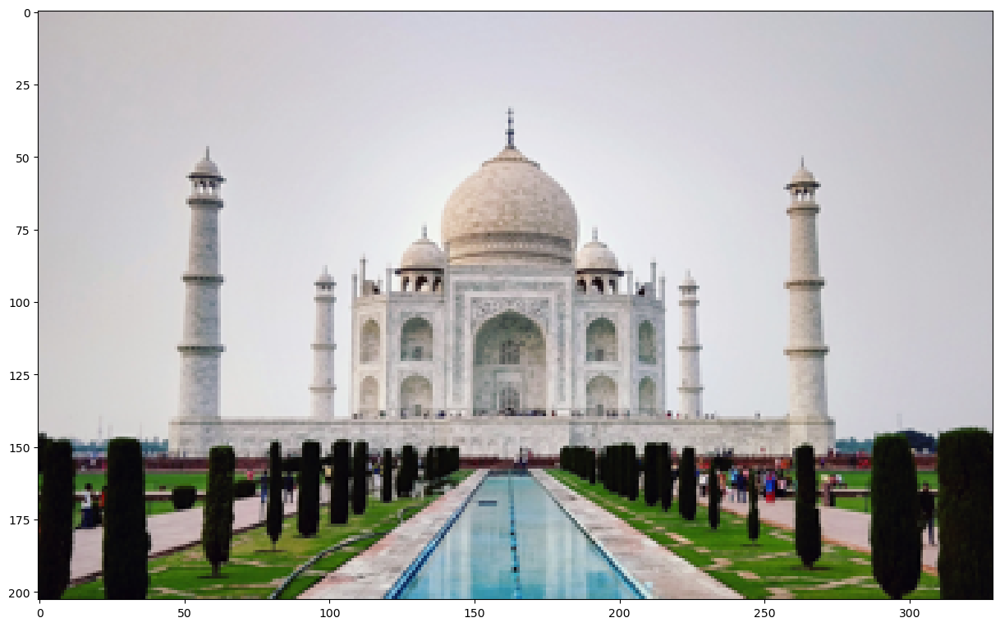

(<Figure size 1500x1000 with 1 Axes>,
 None)

In [14]:
#Giriş görüntüsünden beş satırdaki her satırı ve beş sütundaki her sütunu seçerek 
#giriş görüntüsünün genişliğini ve yüksekliğini beş kat azalt (görüntünün boyutunu 25 kat azaltın):



im = im.resize((im.width//5, im.height//5))
pylab.figure(figsize=(15,10)), pylab.imshow(im), pylab.show()

#Gördüğünüz gibi, orijinal görüntüde bulunmayan bazı siyah yamalar/artefaktlar ve desenler içermektedir - aliasing.
# Aliasing tipik olarak örnekleme hızı Nyquist hızından daha düşük olduğu için (çok az piksel!) meydana gelir 
# (bu nedenle örtüşmeyi önlemenin bir yolu örnekleme hızını Nyquist hızının üzerine çıkarmaktır, 
# ancak daha küçük boyutlu bir çıktı görüntüsü isteniyorsa ne yapılması gerekir?)

#https://sandipanweb.wordpress.com/2018/01/21/recursive-graphics-bilinear-interpolation-and-image-transformation-in-python/

C:\Users\MKOTAN\AppData\Local\Temp\ipykernel_18768\3957271247.py:10: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  im = im.resize((im.width//5, im.height//5), Image.ANTIALIAS)


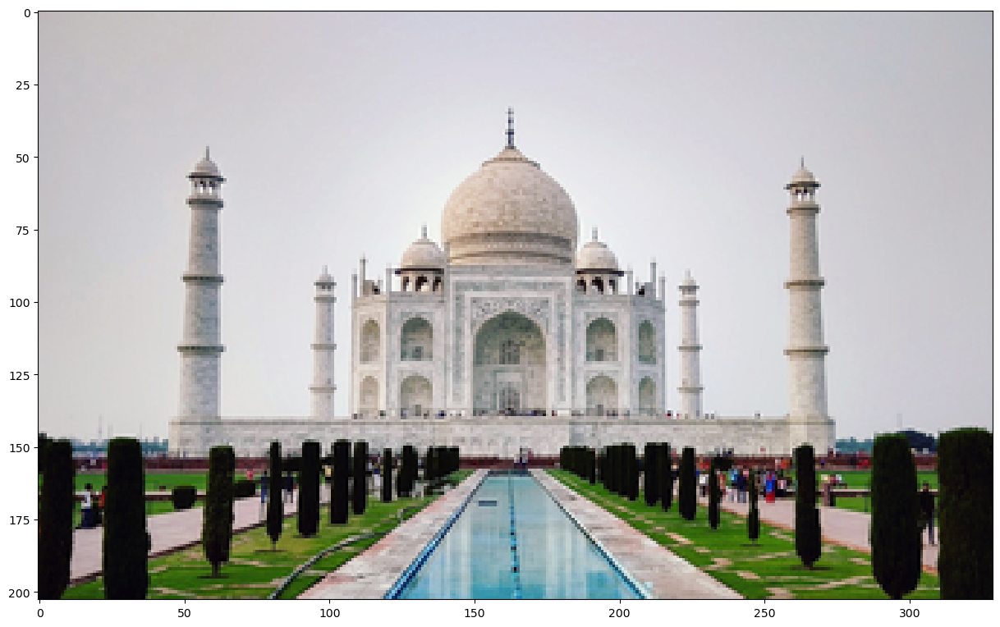

(<Figure size 1500x1000 with 1 Axes>,
 None)

In [9]:
# Down-sampling and anti-aliasing
# Aşağı örnekleme bir örtüşme etkisi yarattığı için görüntüleri küçültmek için çok iyi değildir.
# Anti-aliasing
# Buradaki sorun, çıktı görüntüsündeki tek bir pikselin girdi görüntüsündeki 25 piksele karşılık gelmesi, 
# ancak bunun yerine tek bir pikselin değerini örneklememizdir. 
# Giriş görüntüsündeki küçük bir alanın ortalamasını almamız gerekir. 
# ANTIALIAS (yüksek kaliteli bir aşağı örnekleme filtresi) kullanılarak yapılabilir;

im = Image.open("Ims/tajmahal.jpg")
im = im.resize((im.width//5, im.height//5), Image.ANTIALIAS)
pylab.figure(figsize=(15,10)), pylab.imshow(im), pylab.show()


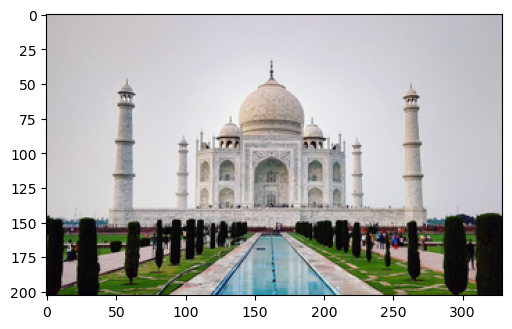

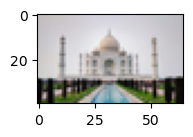

C:\Users\MKOTAN\AppData\Local\Temp\ipykernel_18768\1052330217.py:5: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  im2 = im.resize((im.width//5, im.height//5), Image.ANTIALIAS)


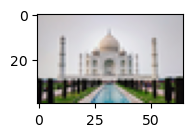

(<Axes: >, <matplotlib.image.AxesImage at 0x26c1b13d4c0>, None)

In [10]:
pylab.figure(figsize=(20,15))
pylab.subplot(1,3,1), pylab.imshow(im), pylab.show()
im1 = im.resize((im.width//5, im.height//5))
pylab.subplot(1,3,2), pylab.imshow(im1), pylab.show()
im2 = im.resize((im.width//5, im.height//5), Image.ANTIALIAS)
pylab.subplot(1,3,3), pylab.imshow(im2), pylab.show()


C:\Users\MKOTAN\AppData\Local\Temp\ipykernel_18768\325387454.py:10: FutureWarning: `multichannel` is a deprecated argument name for `rescale`. It will be removed in version 1.0. Please use `channel_axis` instead.
  im1 = rescale(im1, scale = 0.5, multichannel=True, anti_aliasing=False)


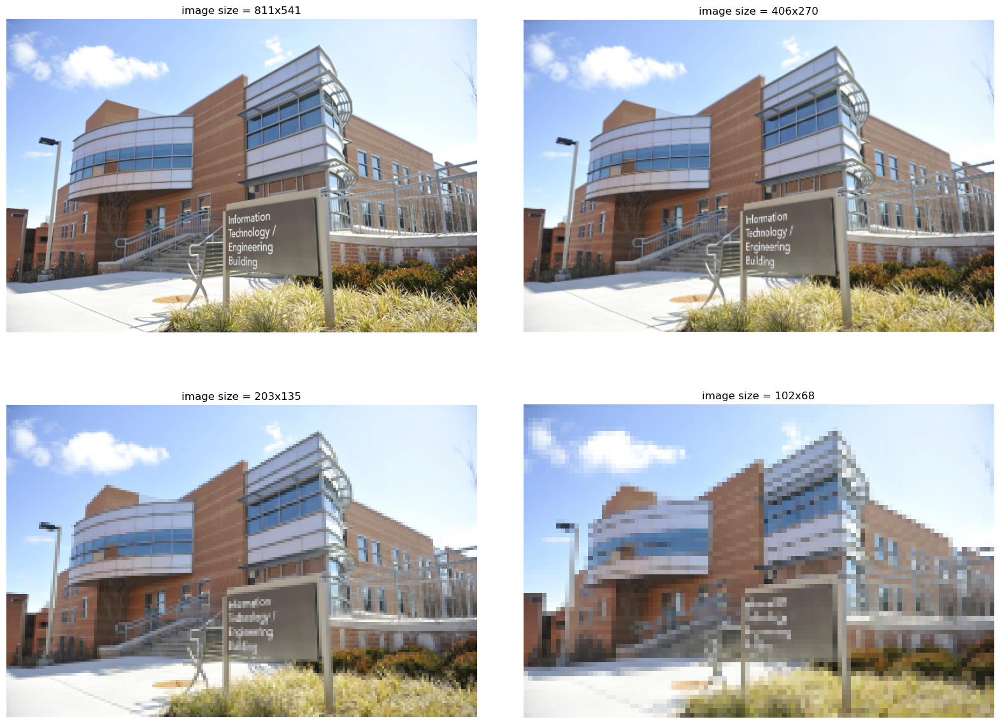

In [11]:
#Anti aliasing kenar yumuşatma genellikle aşağı örneklemeden önce bir görüntüyü yumuşatarak 
#(Gauss filtresi gibi düşük geçişli bir filtre ile görüntünün konvolüsyonu yoluyla) yapılır.

im = imread('Ims/umbc.png')
im1 = im.copy()
pylab.figure(figsize=(20,15))
for i in range(4):
    pylab.subplot(2,2,i+1), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
    pylab.title('image size = ' + str(im1.shape[1]) + 'x' + str(im1.shape[0]))
    im1 = rescale(im1, scale = 0.5, multichannel=True, anti_aliasing=False)
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()


# Görülebileceği gibi, görüntü daha küçük ve daha küçük çıktılar oluşturmak için aşağı örneklenir 
# Anti aliasing tekniği kullanılmadığında aliasing etkisi daha belirgin hale gelir:

C:\Users\MKOTAN\AppData\Local\Temp\ipykernel_18768\3574320959.py:8: FutureWarning: `multichannel` is a deprecated argument name for `rescale`. It will be removed in version 1.0. Please use `channel_axis` instead.
  im1 = rescale(im1, scale = 0.5, multichannel=True, anti_aliasing=True)


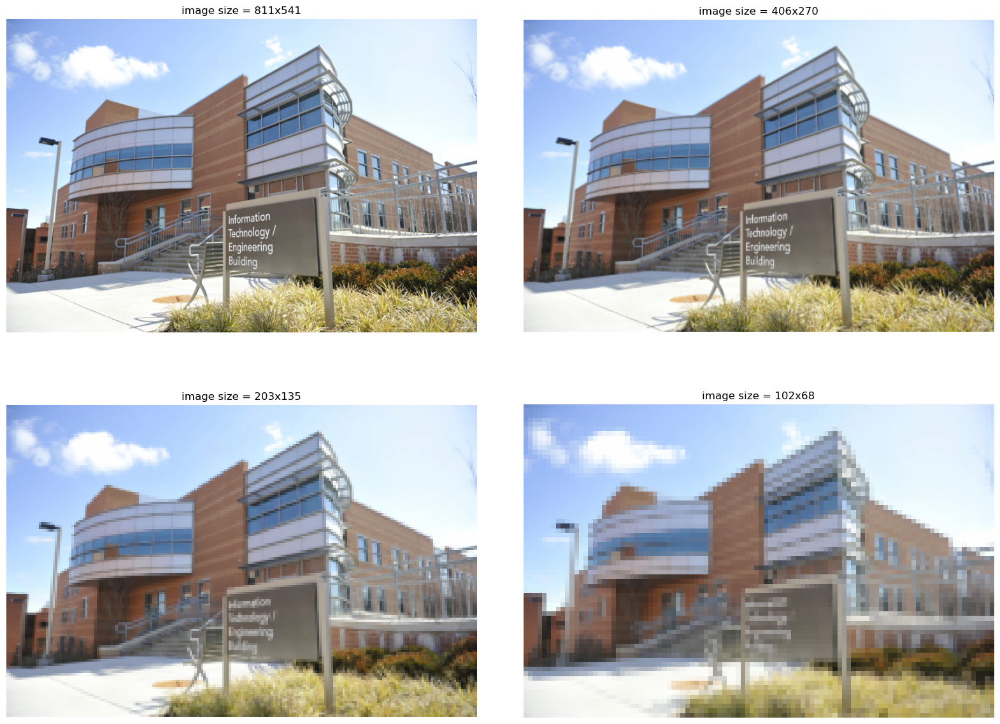

In [12]:
# yukarıdaki kod için anti aliasing=True yapalım.
im = imread('Ims/umbc.png')
im1 = im.copy()
pylab.figure(figsize=(20,15))
for i in range(4):
    pylab.subplot(2,2,i+1), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
    pylab.title('image size = ' + str(im1.shape[1]) + 'x' + str(im1.shape[0]))
    im1 = rescale(im1, scale = 0.5, multichannel=True, anti_aliasing=True)
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()


### Quantization

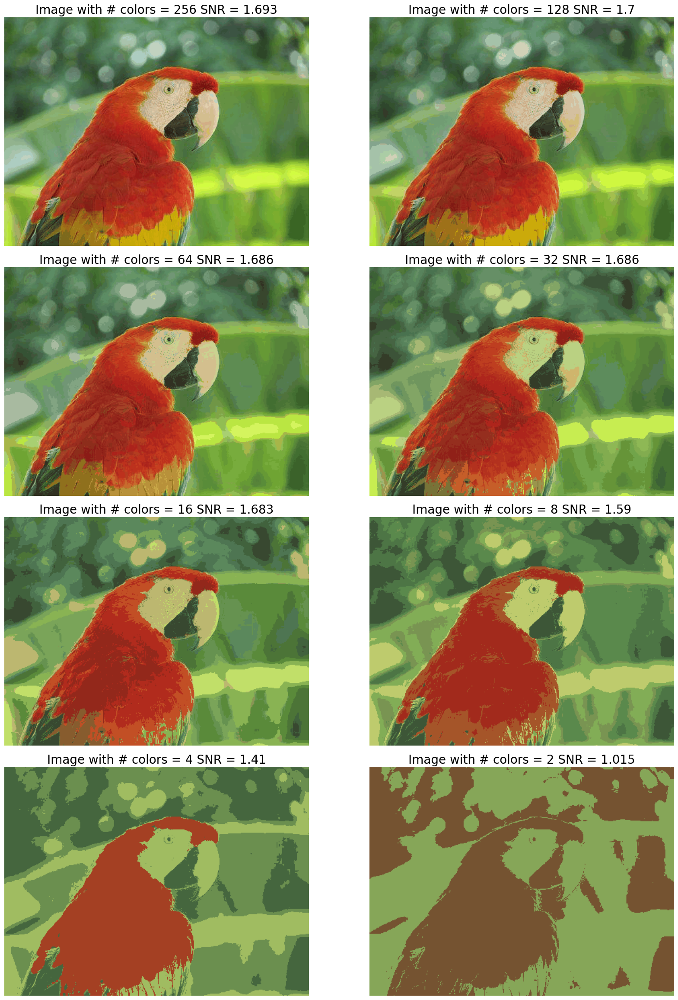

In [13]:
# Niceleme bir görüntünün yoğunluğu ile ilgilidir ve piksel başına kullanılan bit sayısı ile tanımlanabilir. 
# Dijital görüntüler tipik olarak 256 gri seviyeye kuantize edilir. 
# Piksel depolama için bit sayısı azaldıkça niceleme hatasının artar, yapay sınırlara veya konturlara ve pikselleşmeye 
# yol açar ve görüntünün düşük kaliteye sahip olmasına neden olur.

# PIL ile Quantizing

# Bir pikseli depolamak için kullanılan bit sayısı azaldıkça renk nicelemesiyle görüntü kalitesinin nasıl düştüğünü gösterilmektedir:

# SNR için bknz: https://tr.wikipedia.org/wiki/Sinyal_G%C3%BCr%C3%BClt%C3%BC_Oran%C4%B1

im = Image.open('Ims/parrot.jpg')
pylab.figure(figsize=(20,30))
num_colors_list = [1 << n for n in range(8,0,-1)]
snr_list = []
i = 1
for num_colors in num_colors_list:
    im1 = im.convert('P', palette=Image.ADAPTIVE, colors=num_colors)
    pylab.subplot(4,2,i), pylab.imshow(im1), pylab.axis('off')
    snr_list.append(signaltonoise(im1, axis=None))
    pylab.title('Image with # colors = ' + str(num_colors) + ' SNR = ' +
    str(np.round(snr_list[i-1],3)), size=20)
    i += 1
pylab.subplots_adjust(wspace=0.2, hspace=0)
pylab.show()

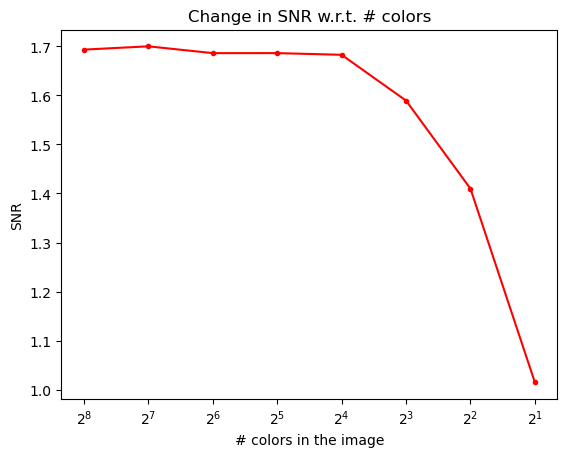

In [9]:
# renk nicelemenin görüntü SNR'si üzerindeki etkisi: 
# genellikle SNR ne kadar yüksekse kalite o kadar iyidir:

# Renk nicelemesi görüntü boyutunu azaltsa da (bit/piksel sayısı azaldığı için), 
# SNR ile ölçülen görüntü kalitesini de düşürmektedir

pylab.plot(num_colors_list, snr_list, 'r.-')
pylab.xlabel('# colors in the image')
pylab.ylabel('SNR')
pylab.title('Change in SNR w.r.t. # colors')
#pylab.xscale('log',basex=2)
pylab.xscale('log',base=2)
pylab.gca().invert_xaxis()
pylab.show()

# Discrete Fourier Transform

In [11]:
# Fourier dönüşümü yönteminin uzun bir matematiksel geçmişi vardır 
# Bknz: Digital Image Processing - Rafael C. Gonzalez and Richard E. Woods
#       http://www.zafercomert.com/IcerikDetay.aspx?zcms=157
#       https://tr.wikipedia.org/wiki/Fourier_d%C3%B6n%C3%BC%C5%9F%C3%BCm%C3%BC

# Görüntü işleme konusu amaçlı sadece 2D Ayrık Fourier Dönüşümü (DFT) üzerine odaklanacağız. 
# Fourier dönüşümü yönteminin arkasındaki temel fikir, bir görüntünün iki boyut boyunca sinüs ve kosinüslerin 
# (Fourier temel fonksiyonları) ağırlıklı bir toplamı olarak ifade edilebilen 2D bir fonksiyon, f, olarak düşünülebileceğidir.

# DFT'yi kullanarak görüntüdeki bir dizi gri tonlamalı piksel değerinden (uzamsal/zaman etki alanı) 
# bir dizi Fourier katsayısına (frekans etki alanı) geçiş yapabiliriz ve kullanılacak uzamsal ve dönüşüm değişkenleri 
# yalnızca bir dizi ayrık ardışık tamsayı değeri (tipik olarak görüntüyü temsil eden bir 2D dizinin konumları) 
# alabildiğinden dolayı ayrıktır.

# Benzer bir şekilde, Fourier katsayılarının frekans alanı 2D dizisi, 
# Fourier katsayılarını kullanarak görüntünün yeniden yapılandırılması olarak da bilinen 
# Ters Ayrık Fourier Dönüşümü (IDFT) kullanılarak uzamsal alana geri dönüştürülebilir. 

# DFT ve IDFT matematiksel olarak aşağıdaki gibi tanımlanır:





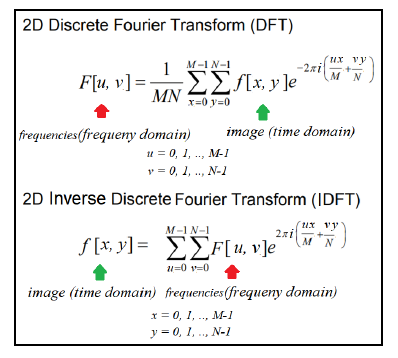

Frekans alanına dönüşüm bir görüntünün daha iyi anlaşılmasını sağlar. 
Frekans alanındaki düşük frekanslar bir görüntüdeki ortalama brüt bilgi seviyesine karşılık gelirken, yüksek frekanslar kenarlara, gürültüye ve daha ayrıntılı bilgilere karşılık gelir. 

Çoğu görüntü az bir DFT katsayısı kullanılarak temsil edilebilir ve geri kalan tüm yüksek katsayılar neredeyse ihmal edilebilir / sıfır olma eğilimindedir.

Bu, özellikle bir görüntüyü yeniden yapılandırmak için yalnızca birkaç Fourier katsayısının gerekli olduğu Fourier-sparse görüntüler için görüntü sıkıştırmada çok kullanışlıdır, dolayısıyla yalnızca bu frekanslar saklanabilir ve diğerleri atılabilir, bu da yüksek sıkıştırmaya yol açar (örneğin, JPEG görüntü sıkıştırma algoritmasında benzer bir dönüşüm olan Ayrık Kosinüs Dönüşümü (DCT) kullanılır. 

FFT (Fast Fourier Dönüşümü)

Hızlı Fourier Dönüşümü (FFT), DFT'yi n x n görüntü için çok daha hızlı zaman karmaşıklığı ile özyinelemeli olarak hesaplamak için bir böl ve yönet algoritmasıdır. Python'da hem numpy hem de scipy kütüphaneleri, FFT algoritmasını kullanarak 2D DFT/IDFT hesaplamak için fonksiyonlar sağlar. 

https://en.wikipedia.org/wiki/Fast_Fourier_transform#:~:text=A%20fast%20Fourier%20transform%20(FFT,frequency%20domain%20and%20vice%20versa.

https://en.wikipedia.org/wiki/Divide-and-conquer_algorithm#:~:text=A%20divide%2Dand%2Dconquer%20algorithm,solution%20to%20the%20original%20problem.




SNR for the original image = 2.032390538354219
SNR for the image obtained after reconstruction = 2.032390538354219


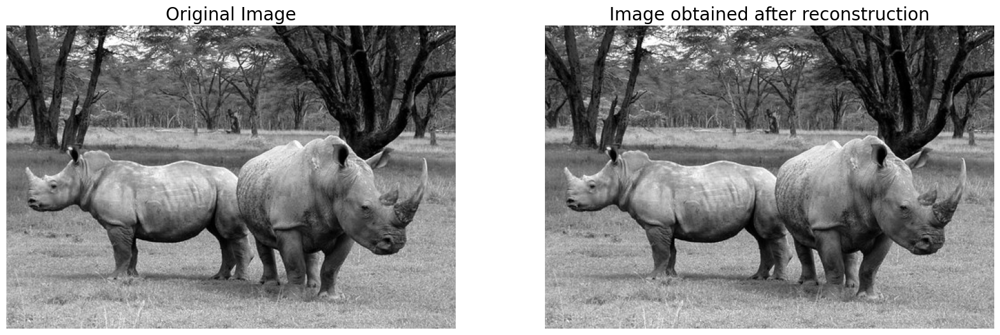

In [14]:
# scipy.fftpack modülünden fft2()/ifft2()

im = np.array(Image.open('Ims/rhino.jpg').convert('L')) 
snr = signaltonoise(im, axis=None)
print('SNR for the original image = ' + str(snr))
# SNR for the original image = 2.023722773801701
# now call FFT and IFFT
freq = fp.fft2(im)
im1 = fp.ifft2(freq).real
snr = signaltonoise(im1, axis=None)
print('SNR for the image obtained after reconstruction = ' + str(snr))
# SNR for the image obtained after reconstruction = 2.0237227738013224
assert(np.allclose(im, im1)) # make sure the forward and inverse FFT are close to each other
pylab.figure(figsize=(20,10))
pylab.subplot(121), pylab.imshow(im, cmap='gray'), pylab.axis('off')
pylab.title('Original Image', size=20)
pylab.subplot(122), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
pylab.title('Image obtained after reconstruction', size=20)
pylab.show()

C:\Users\MKOTAN\AppData\Local\Temp\ipykernel_18768\3971061142.py:9: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.figure(figsize=(10,10)), pylab.imshow( (20*np.log10( 0.1 + freq2)).astype(int)), pylab.show()


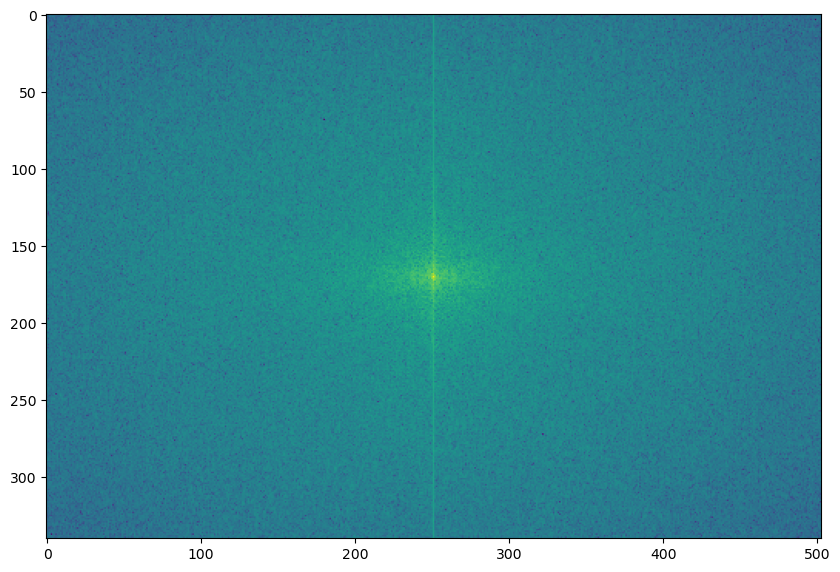

(<Figure size 1000x1000 with 1 Axes>,
 None)

In [15]:
# Frekans spektrumunu çizme
# Fourier katsayıları karmaşık sayılar olduğundan, büyüklükleri doğrudan görüntüleyebiliriz. 
# Fourier dönüşümlerinin büyüklüklerinin görüntülenmesine dönüşüm spektrumu denir. DFT'nin F [0,0] değeri DC katsayısı olarak adlandırılır. 
# DC katsayısı diğer katsayı değerlerinin görülemeyeceği kadar büyüktür, 
# bu nedenle dönüşümün logaritmasını görüntüleyerek dönüşüm değerlerini esnetmemiz gerekir. 

# the quadrants are needed to be shifted around in order that the low spatial frequencies are in the center of the 2D fourier-transformed image.
freq2 = fp.fftshift(freq)
pylab.figure(figsize=(10,10)), pylab.imshow( (20*np.log10( 0.1 + freq2)).astype(int)), pylab.show()

# Rhino görüntüsünün Fourier spektrumundaki görünümü

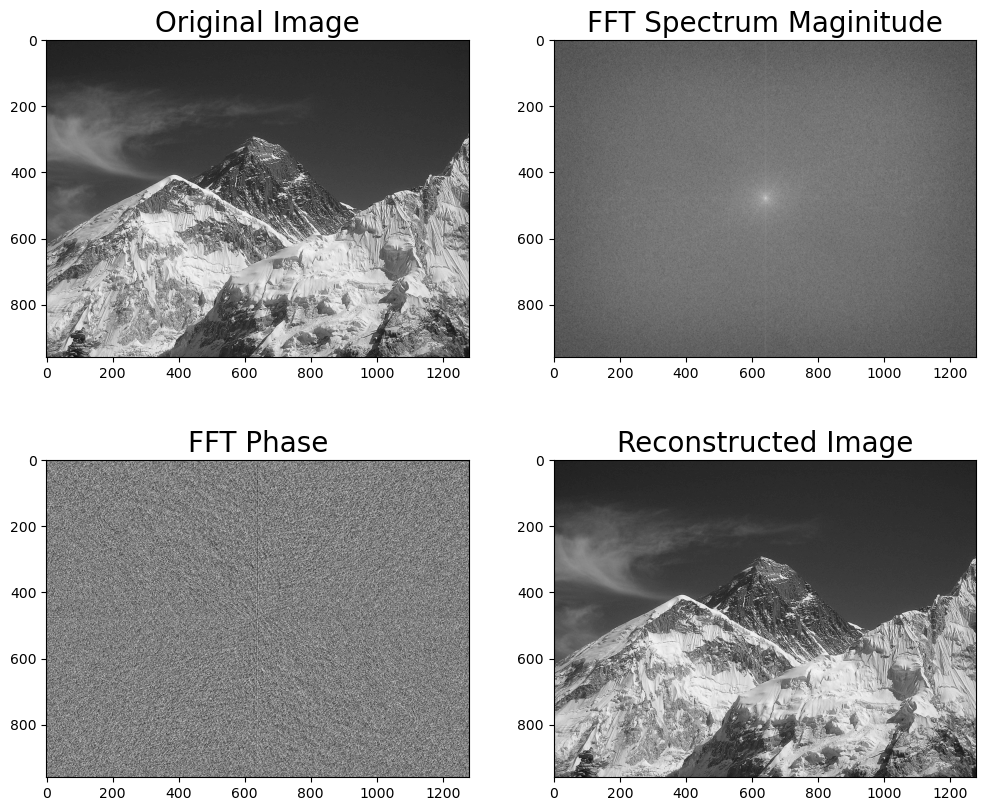

In [16]:
# FFT - numpy.fft modul

# DFT'nin büyüklüğünü ve fazını hesaplama

# daha fazla bilgi için lütfen inceleyin : https://www.cs.unm.edu/~brayer/vision/fourier.html

import numpy.fft as fp
im1 = rgb2gray(imread('Ims/hill.jpg'))
pylab.figure(figsize=(12,10))
freq1 = fp.fft2(im1)
im1_ = fp.ifft2(freq1).real
pylab.subplot(2,2,1), pylab.imshow(im1, cmap='gray'), pylab.title('Original Image', size=20)
pylab.subplot(2,2,2), pylab.imshow(20*np.log10( 0.01 +
np.abs(fp.fftshift(freq1))), cmap='gray')
pylab.title('FFT Spectrum Maginitude', size=20)
pylab.subplot(2,2,3), pylab.imshow(np.angle(fp.fftshift(freq1)),cmap='gray')
pylab.title('FFT Phase', size=20)
pylab.subplot(2,2,4), pylab.imshow(np.clip(im1_,0,255), cmap='gray')
pylab.title('Reconstructed Image', size=20)
pylab.show()

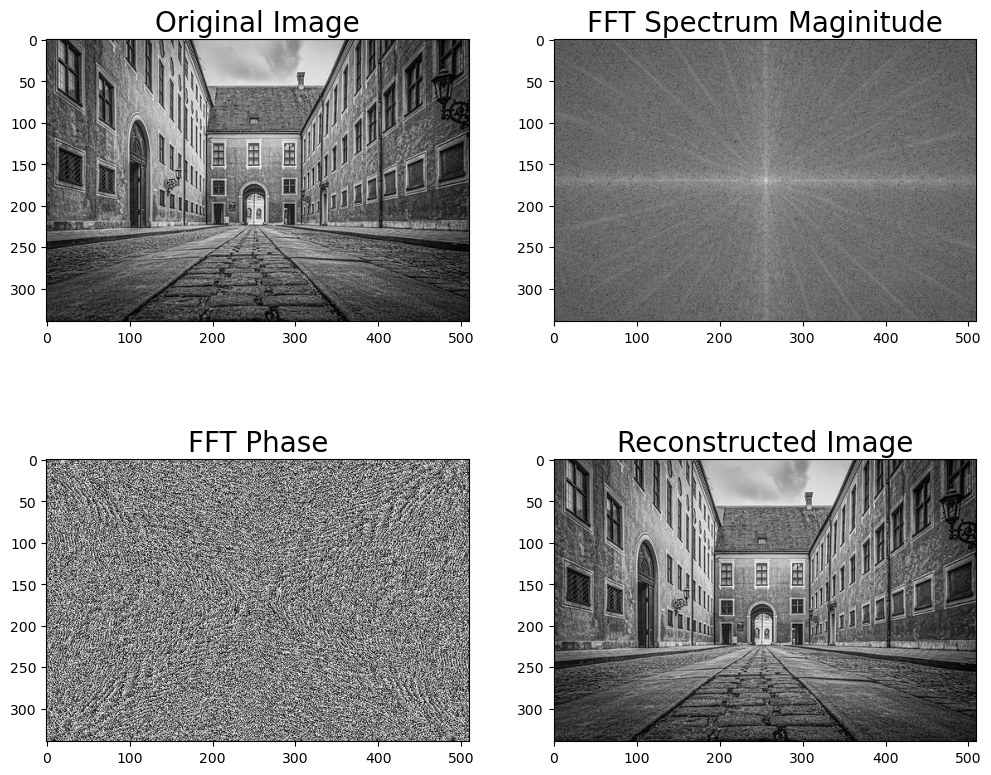

In [22]:
im1 = rgb2gray(imread('Ims/house.png')[:,:,:3])  # 4 kanallıda hata almamak için
pylab.figure(figsize=(12,10))
freq1 = fp.fft2(im1)
im1_ = fp.ifft2(freq1).real
pylab.subplot(2,2,1), pylab.imshow(im1, cmap='gray'), pylab.title('Original Image', size=20)
pylab.subplot(2,2,2), pylab.imshow(20*np.log10( 0.01 +
np.abs(fp.fftshift(freq1))), cmap='gray')
pylab.title('FFT Spectrum Maginitude', size=20)
pylab.subplot(2,2,3), pylab.imshow(np.angle(fp.fftshift(freq1)),cmap='gray')
pylab.title('FFT Phase', size=20)
pylab.subplot(2,2,4), pylab.imshow(np.clip(im1_,0,255), cmap='gray')
pylab.title('Reconstructed Image', size=20)
pylab.show()

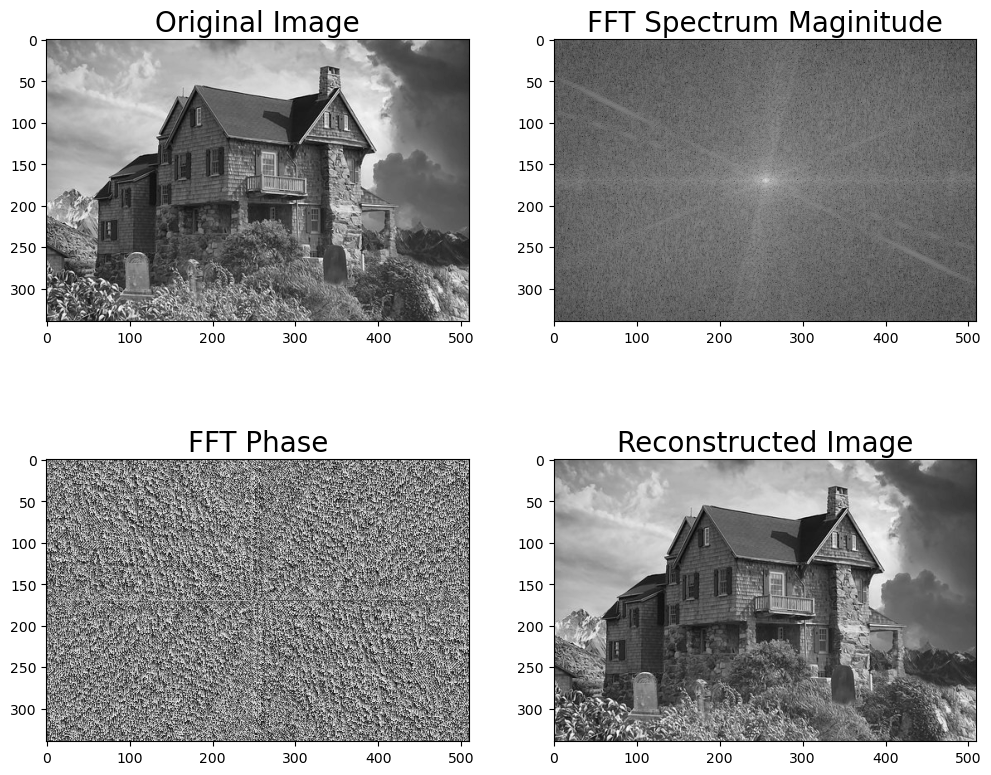

In [24]:
im2 = rgb2gray(imread('Ims/house2.png')[:,:,:3])
pylab.figure(figsize=(12,10))
freq2 = fp.fft2(im2)
im2_ = fp.ifft2(freq2).real
pylab.subplot(2,2,1), pylab.imshow(im2, cmap='gray'), pylab.title('Original Image', size=20)
pylab.subplot(2,2,2), pylab.imshow(20*np.log10( 0.01 +
np.abs(fp.fftshift(freq2))), cmap='gray')
pylab.title('FFT Spectrum Maginitude', size=20)
pylab.subplot(2,2,3), pylab.imshow(np.angle(fp.fftshift(freq2)), cmap='gray')
pylab.title('FFT Phase', size=20)
pylab.subplot(2,2,4), pylab.imshow(np.clip(im2_,0,255), cmap='gray')
pylab.title('Reconstructed Image', size=20)
pylab.show()

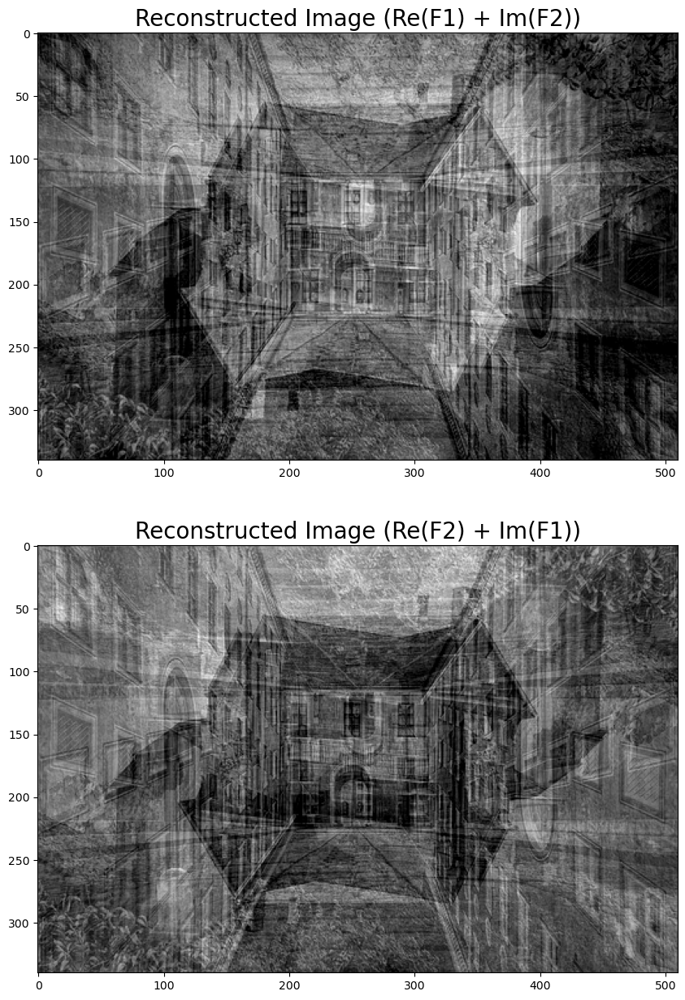

In [25]:
# Büyüklük kadar bilgilendirici olmasa da, DFT fazı da önemli bir bilgidir ve 
# faz mevcut değilse veya farklı bir faz dizisi kullanırsak bir görüntü düzgün bir şekilde yeniden yapılandırılamaz.

# frekans spektrumunun real bileşenlerini bir görüntüden ve imaginary bileşenlerini başka bir görüntüden kullanırsak, 
# yeniden yapılandırılmış bir çıktı görüntüsünün nasıl bozulduğunu görelim:

pylab.figure(figsize=(20,15))
im1_ = fp.ifft2(np.vectorize(complex)(freq1.real, freq2.imag)).real
im2_ = fp.ifft2(np.vectorize(complex)(freq2.real, freq1.imag)).real
pylab.subplot(211), pylab.imshow(np.clip(im1_,0,255), cmap='gray')
pylab.title('Reconstructed Image (Re(F1) + Im(F2))', size=20)
pylab.subplot(212), pylab.imshow(np.clip(im2_,0,255), cmap='gray')
pylab.title('Reconstructed Image (Re(F2) + Im(F1))', size=20)
pylab.show()

# Konvolüsyon

Konvolüsyon, biri giriş görüntüsü ve diğeri giriş görüntüsü üzerinde bir filtre olarak bir maske (çekirdek olarak da adlandırılır) olmak üzere iki görüntü üzerinde çalışan ve bir çıkış görüntüsü üreten bir işlemdir.

Konvolüsyon filtreleme, bir görüntünün uzamsal frekans özelliklerini değiştirmek için kullanılır. 

Çıktı görüntüsündeki pikselin yeni değerini hesaplamak için tüm komşularının ağırlıklı değerlerini bir araya getirerek merkezi bir pikselin değerini belirleyerek çalışır. 

Çıktı görüntüsündeki piksel değerleri, bir sonraki ekran görüntüsünde gösterildiği gibi (geçerli modla konvolüsyon için; konvolüsyon modlarına değineceğiz) çekirdek penceresinin girdi görüntüsü boyunca gezdirilmesiyle hesaplanır:

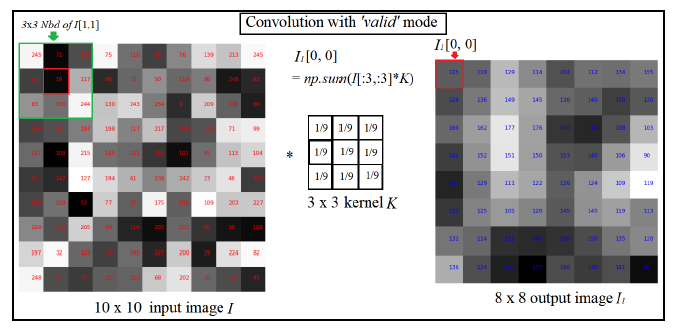

giriş görüntüsünde bir okla işaretlenmiş olan çekirdek penceresi görüntü boyunca ilerler ve konvolüsyon işleminden sonra çıkış görüntüsüne eşlenen değerleri elde eder.


Konvolüsyon, giriş görüntüsü üzerinde genel amaçlı bir filtre efekti uygular. Bu, bir görüntü üzerinde uygun çekirdeklerle yumuşatma, keskinleştirme ve kabartma gibi çeşitli efektler elde etmek için ve kenar algılama gibi işlemlerde yapılır.


0.9921568627450982
(256, 256)


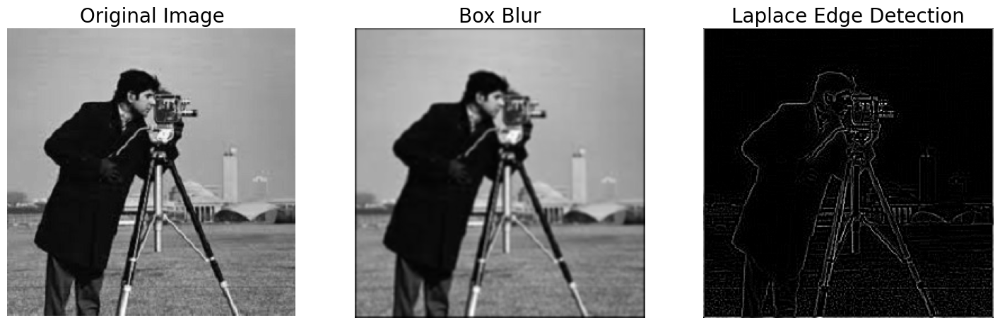

In [17]:
# Gri tonlamalı bir görüntüye konvolüsyon uygulama

# İlk olarak Laplace çekirdeği ile konvolüsyon kullanarak 
# gri tonlamalı cameraman.jpg görüntüsünden kenarları tespit etme ve 
# box çekirdeği kullanarak bir görüntüyü bulanıklaştıma:

im = rgb2gray(imread('Ims/cameraman.jpg')).astype(float)
print(np.max(im))
print(im.shape)
blur_box_kernel = np.ones((3,3)) / 9
edge_laplace_kernel = np.array([[0,1,0],[1,-4,1],[0,1,0]])
im_blurred = signal.convolve2d(im, blur_box_kernel)
im_edges = np.clip(signal.convolve2d(im, edge_laplace_kernel), 0, 1)
fig, axes = pylab.subplots(ncols=3, sharex=True, sharey=True, figsize=(18,6))
axes[0].imshow(im, cmap=pylab.cm.gray)
axes[0].set_title('Original Image', size=20)
axes[1].imshow(im_blurred, cmap=pylab.cm.gray)
axes[1].set_title('Box Blur', size=20)
axes[2].imshow(im_edges, cmap=pylab.cm.gray)
axes[2].set_title('Laplace Edge Detection', size=20)
for ax in axes:
    ax.axis('off')
pylab.show()

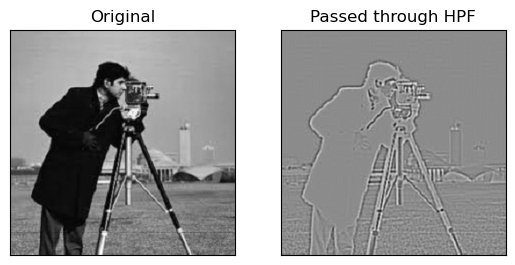

In [18]:
import cv2
import matplotlib.pyplot as plt
edges = cv2.Laplacian(im, -1, ksize=5, scale=1,delta=0,borderType=cv2.BORDER_DEFAULT)
output = [im, edges]
titles = ['Original', 'Passed through HPF']

for i in range(2):
    plt.subplot(1, 2, i + 1)
    plt.imshow(output[i], cmap='gray')
    plt.title(titles[i])
    plt.xticks([])
    plt.yticks([])
plt.show()

1.0
(1018, 1645, 3)


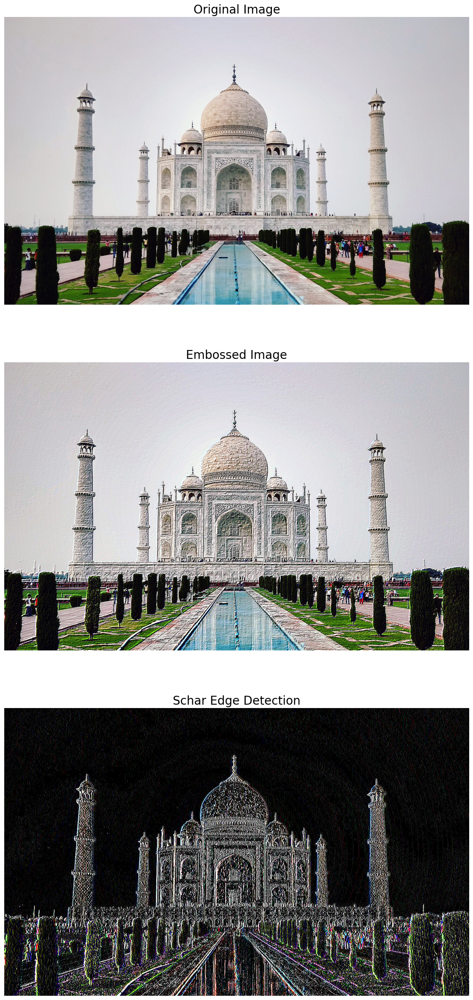

In [19]:
#Renkli (RGB) bir görüntüye konvolüsyon uygulama

# scipy.convolve2d() ile bir RGB görüntüsünü de netleştirebiliriz. 
# Konvolüsyonu her görüntü kanalı için ayrı ayrı uygulamamız gerekir.

# emboss kernel ve schar edge detection complex kernel:

im = imread('Ims/tajmahal.jpg')/255 # scale each pixel value in [0,1]
print(np.max(im))
print(im.shape)
emboss_kernel = np.array([[-2,-1,0],[-1,1,1],[0,1,2]])
edge_schar_kernel = np.array([[ -3-3j, 0-10j, +3 -3j], [-10+0j, 0+ 0j, +10+0j], [ -3+3j, 0+10j, +3 +3j]])
im_embossed = np.ones(im.shape)
im_edges = np.ones(im.shape)
for i in range(3):
    im_embossed[...,i] = np.clip(signal.convolve2d(im[...,i], emboss_kernel, mode='same', boundary="symm"),0,1)
for i in range(3):
    im_edges[:,:,i] = np.clip(np.real(signal.convolve2d(im[...,i], edge_schar_kernel, mode='same', boundary="symm")),0,1)
fig, axes = pylab.subplots(nrows=3, figsize=(20, 30))
axes[0].imshow(im)
axes[0].set_title('Original Image', size=20)
axes[1].imshow(im_embossed)
axes[1].set_title('Embossed Image', size=20)
axes[2].imshow(im_edges)
axes[2].set_title('Schar Edge Detection', size=20)
for ax in axes:
    ax.axis('off')
pylab.show()

C:\Users\MKOTAN\AppData\Local\Temp\ipykernel_15220\3065060509.py:6: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  im = imread('ImageProcessingLecture/Ims/tajmahal.jpg').astype(np.float) # read as float


255.0


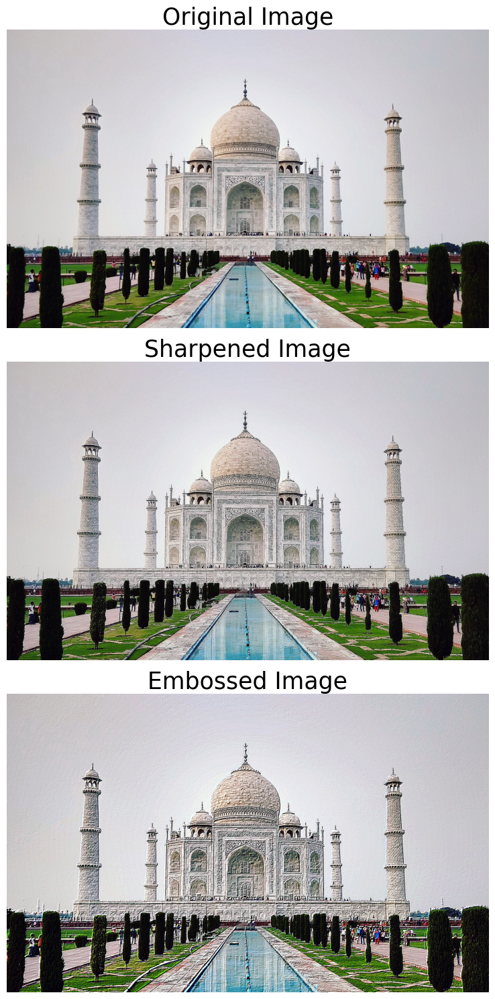

In [37]:
# SciPy ndimage.convolve ile konvolüsyon

# scipy.ndimage.convolve() ile bir RGB görüntüsünü doğrudan keskinleştirebiliriz 
# konvolüsyonu her görüntü kanalı için ayrı ayrı uygulamak zorunluluğu yoktur).

im = imread('Ims/tajmahal.jpg').astype(np.float) # read as float
print(np.max(im))
sharpen_kernel = np.array([0, -1, 0, -1, 5, -1, 0, -1, 0]).reshape((3, 3, 1))
emboss_kernel = np.array(np.array([[-2,-1,0],[-1,1,1],[0,1,2]])).reshape((3, 3, 1))
im_sharp = ndimage.convolve(im, sharpen_kernel, mode='nearest')
im_sharp = np.clip(im_sharp, 0, 255).astype(np.uint8) # clip (0 to 255) and convert to unsigned int
im_emboss = ndimage.convolve(im, emboss_kernel, mode='nearest')
im_emboss = np.clip(im_emboss, 0, 255).astype(np.uint8)
pylab.figure(figsize=(10,15))
pylab.subplot(311), pylab.imshow(im.astype(np.uint8)), pylab.axis('off')
pylab.title('Original Image', size=25)
pylab.subplot(312), pylab.imshow(im_sharp), pylab.axis('off')
pylab.title('Sharpened Image', size=25)
pylab.subplot(313), pylab.imshow(im_emboss), pylab.axis('off')
pylab.title('Embossed Image', size=25)
pylab.tight_layout()
pylab.show()

C:\Users\MKOTAN\AppData\Local\Temp\ipykernel_18768\729985783.py:21: DeprecationWarning: scipy.misc.face has been deprecated in SciPy v1.10.0; and will be completely removed in SciPy v1.12.0. Dataset methods have moved into the scipy.datasets module. Use scipy.datasets.face instead.
  face_image = misc.face(gray=True) - misc.face(gray=True).mean()
C:\Users\MKOTAN\AppData\Local\Temp\ipykernel_18768\729985783.py:38: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


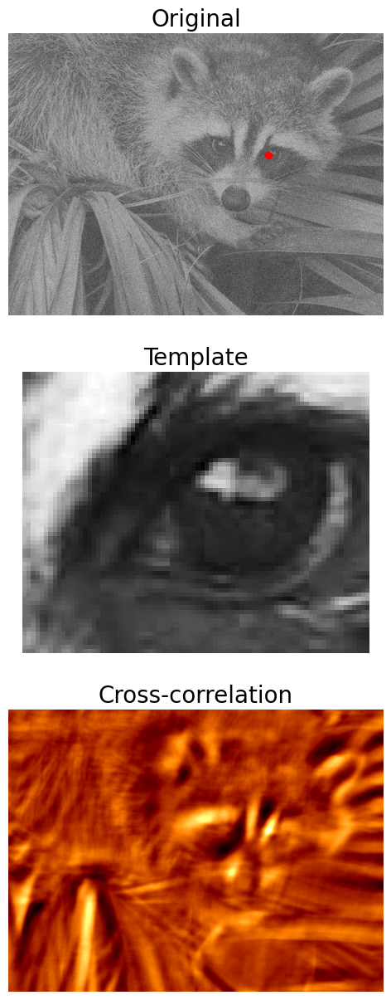

In [20]:
# Korelasyon ve konvolüsyon farkı
# Korelasyon, bir giriş görüntüsü ve başka bir çekirdek alması 
# ve çekirdek değerleri ile piksel komşuluk değerlerinin ağırlıklı 
# bir kombinasyonunu hesaplayarak ve çıkış görüntüsünü üreterek 
# giriş boyunca çekirdek penceresini geçmesi anlamında konvolüsyon işlemine çok benzer.

# Tek fark, korelasyonun aksine, 
# konvolüsyonun ağırlıklı kombinasyonu hesaplamadan önce 
# çekirdeği iki kez (yatay ve dikey eksene göre) çevirmesidir.

# Korelasyon için SciPy signal modülünün correlated2d() fonksiyonu kullanılabilir. 

# Korelasyon, çekirdek simetrik ise konvolüsyona benzer.
# Ancak çekirdek simetrik değilse, convolution2d() ile aynı sonuçları elde etmek için,
# çekirdeği görüntüye yerleştirmeden önce, ters çevirmeli ve soldan sağa çevirmelidir.

# Görüntü ve şablon arasında çapraz korelasyon ile şablon eşleştirme

# Konvolüsyon konularına tekrar değineceğiz.

face_image = misc.face(gray=True) - misc.face(gray=True).mean()
template_image = np.copy(face_image[300:365, 670:750]) # right eye
template_image -= template_image.mean()
face_image = face_image + np.random.randn(*face_image.shape) * 50 # add random noise
correlation = signal.correlate2d(face_image, template_image, boundary='symm', mode='same')
y, x = np.unravel_index(np.argmax(correlation), correlation.shape) # find the match
fig, (ax_original, ax_template, ax_correlation) = pylab.subplots(3, 1, figsize=(6, 15))
ax_original.imshow(face_image, cmap='gray')
ax_original.set_title('Original', size=20)
ax_original.set_axis_off()
ax_template.imshow(template_image, cmap='gray')
ax_template.set_title('Template', size=20)
ax_template.set_axis_off()
ax_correlation.imshow(correlation, cmap='afmhot')
ax_correlation.set_title('Cross-correlation', size=20)
ax_correlation.set_axis_off()
ax_original.plot(x, y, 'ro')
fig.show()


In [21]:
# Alıştırma Sorusu - Sobel ve Canny Edge Detection algorimalarını kendi görüntülerinize uygulayınız.
#https://docs.opencv.org/3.4/d2/d2c/tutorial_sobel_derivatives.html
#https://medium.com/@erhan_arslan/exploring-edge-detection-in-python-2-sobel-edge-detector-a-closer-look-de051a7b56df